![Machine Learning Lab](banner.jpg)

# Laboratorio 2 Actividad

## Instrucciones generales

1. Esta actividad debe ser entregada por BN antes y es de carácter individual. No se permite entregar el laboratorio después de la fecha establecida.
2. Al responder las preguntas de las actividades por favor marcar las respuestas con la sección a la que corresponden, por ejemplo: `## Exploracion de datos 2.1`. Es preferible que esto lo hagan con secciones de MarkDown como en el tutorial.
3. Por favor nombrar el archivo de acuerdo al siguiente formato `{email}_lab2.ipynb`.
4. Si tienen alguna duda pueden escribirme a mi correo `j.rayom@uniandes.edu.co` o contactarme directamente por Teams



### **Actividad: Predicción de reducción de emisiones en proyectos residenciales**

#### **1\. Exploración de Datos (10%)**

1.  **Cargar el dataset**:

    *   Descarga y carga el dataset `programmer3/carbon-reduction-in-residential-construction` usando `curl`. Ver [carbon-reduction-in-residential-construction](https://www.kaggle.com/datasets/programmer3/carbon-reduction-in-residential-construction)
    *   Elimine las columnas no pertinentes.
    *   Inspecciona las primeras filas del dataset para familiarizarte con su estructura.

2.  **Análisis descriptivo**:

    *   Usa `pandas_profiling` o `ydata_profiling` para generar un reporte del dataset.
    *   Responde las siguientes preguntas:
        1.  ¿Cuántas filas y columnas tiene el dataset?
        3.  ¿Cuál es la distribución de la variable objetivo (`Emission_Reduction_Class`)?
        4.  ¿Qué columnas no son numéricas?

#### **2\. Preparación de Datos (20%)**

1.  **Limpieza de datos**:
    *   Elimina las columnas con más del 50% de valores faltantes.
    *   Eliminar las columnas con alto correlacion entre si.
    *   Completa los valores faltantes en las columnas numéricas con la media.
    *   Completa los valores faltantes en las columnas categóricas con el valor más frecuente.

2.  **División de datos**:
    *   Separa el dataset en conjuntos de entrenamiento y prueba (80% train, 20% test).

3.  **Preprocesamiento**:
    *   Normaliza (Z-normalization) las columnas numéricas.
    *   Codifica las columnas categóricas usando `OneHotEncoder`.

#### **3\. Regresión Logística (30%)**

1.  **Entrenamiento del modelo**:
    *   Entrena un modelo de regresión logística para predecir la variable objetivo (`Emission_Reduction_Class`).

2.  **Evaluación del modelo**:
    *   Realiza predicciones sobre el conjunto de prueba.
    *   Calcula las métricas de evaluación: `precision`, `recall`, y `f1-score` para cada clase.
    *   Genera una matriz de confusión para visualizar el rendimiento del modelo.


#### **4\. Regularización y Optimización (40%)**

1.  **Regularización**:
    *   Entrena un modelo de regresión logística con regularización `L2` (`C=1.0`).
    *   Compara las métricas de evaluación (`precision`, `recall`, y `f1-score`) con el modelo sin regularización.

2.  **Optimización de hiperparámetros**:
    *   Usa `GridSearchCV` para encontrar los mejores hiperparámetros (`penalty` y `C`) para el modelo de regresión logística.
    *   Entrena el modelo optimizado y evalúa su rendimiento en el conjunto de prueba.
    *   Responde: ¿Mejoró el rendimiento del modelo después de la optimización?

---


#### **1. Exploración de Datos**

1.  **Cargar el dataset**:

    *   Descarga y carga el dataset `programmer3/carbon-reduction-in-residential-construction` usando `curl`. Ver [carbon-reduction-in-residential-construction](https://www.kaggle.com/datasets/programmer3/carbon-reduction-in-residential-construction)
    *   Elimine las columnas no pertinentes.
    *   Inspecciona las primeras filas del dataset para familiarizarte con su estructura.

In [5]:
!curl -L -o datasets/carbon-reduction-in-residential-construction.zip https://www.kaggle.com/api/v1/datasets/download/programmer3/carbon-reduction-in-residential-construction

!unzip datasets/carbon-reduction-in-residential-construction.zip -d datasets/carbon-reduction-in-residential-construction

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100 72327  100 72327    0     0   109k      0 --:--:-- --:--:-- --:--:--  109k
Archive:  datasets/carbon-reduction-in-residential-construction.zip
  inflating: datasets/carbon-reduction-in-residential-construction/Policy_Driven_Carbon_Reduction_1640.csv  


In [1]:
# librerias
import pandas as pd
from ydata_profiling import ProfileReport

from sklearn.model_selection import train_test_split
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler

from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.model_selection import GridSearchCV

import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

import warnings
warnings.filterwarnings('ignore')

/Users/estefanialaverdebecerra/Library/Python/3.9/lib/python/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(


In [2]:
# lectura y revisión de los datos
df_carbon_reduction = pd.read_csv('datasets/carbon-reduction-in-residential-construction/Policy_Driven_Carbon_Reduction_1640.csv')
df_carbon_reduction.head()

,Project_ID,Project_Type,Building_Area_m2,Green_Certification_Level,Policy_Interventions,Lifecycle_Phase,Embodied_Emissions_tCO2e,Operational_Emissions_tCO2e,Supply_Chain_Emission_Share_%,ReadyMix_Concrete_Emission_tCO2e,Electric_Power_Emission_tCO2e,Lighting_Fixture_Emission_tCO2e,Material_Reuse_%,Renewable_Energy_%,Waste_Minimization_%,Urban_Sustainability_Score,Total_Lifecycle_Emissions_tCO2e,Emission_Reduction_%,Emission_Reduction_Class
0,P0001,High-rise,8702,Silver,2,Operation,956.45,725.68,55.2,534.28,383.47,38.27,45.0,65.4,15.2,87.9,1682.13,24.8,Medium
1,P0002,Low-rise,2368,Basic,2,Construction,1211.80,769.83,62.3,946.28,1035.56,260.64,16.1,10.3,2.5,50.3,1981.63,19.8,Medium
2,P0003,High-rise,15061,Platinum,2,Operation,210.56,2354.05,78.6,364.31,355.47,263.17,32.6,56.7,2.6,37.3,2564.61,44.3,High
3,P0004,High-rise,16012,Platinum,0,Operation,341.32,342.76,32.8,474.13,958.84,152.18,35.4,57.6,1.7,37.5,684.08,38.3,High
4,P0005,Low-rise,15399,Gold,0,End-of-life,1786.26,1806.09,58.7,808.26,676.74,163.98,38.9,49.6,16.4,69.7,3592.35,28.2,Medium


Observamos que la columna Project_ID no es relevante para el análisis, por lo que la eliminamos.

In [3]:
df_carbon_reduction = df_carbon_reduction.drop(columns=['Project_ID'])
df_carbon_reduction.head()

,Project_Type,Building_Area_m2,Green_Certification_Level,Policy_Interventions,Lifecycle_Phase,Embodied_Emissions_tCO2e,Operational_Emissions_tCO2e,Supply_Chain_Emission_Share_%,ReadyMix_Concrete_Emission_tCO2e,Electric_Power_Emission_tCO2e,Lighting_Fixture_Emission_tCO2e,Material_Reuse_%,Renewable_Energy_%,Waste_Minimization_%,Urban_Sustainability_Score,Total_Lifecycle_Emissions_tCO2e,Emission_Reduction_%,Emission_Reduction_Class
0,High-rise,8702,Silver,2,Operation,956.45,725.68,55.2,534.28,383.47,38.27,45.0,65.4,15.2,87.9,1682.13,24.8,Medium
1,Low-rise,2368,Basic,2,Construction,1211.80,769.83,62.3,946.28,1035.56,260.64,16.1,10.3,2.5,50.3,1981.63,19.8,Medium
2,High-rise,15061,Platinum,2,Operation,210.56,2354.05,78.6,364.31,355.47,263.17,32.6,56.7,2.6,37.3,2564.61,44.3,High
3,High-rise,16012,Platinum,0,Operation,341.32,342.76,32.8,474.13,958.84,152.18,35.4,57.6,1.7,37.5,684.08,38.3,High
4,Low-rise,15399,Gold,0,End-of-life,1786.26,1806.09,58.7,808.26,676.74,163.98,38.9,49.6,16.4,69.7,3592.35,28.2,Medium


2.  **Análisis descriptivo**:

    *   Usa `pandas_profiling` o `ydata_profiling` para generar un reporte del dataset.
    *   Responde las siguientes preguntas:
        1.  ¿Cuántas filas y columnas tiene el dataset?
        3.  ¿Cuál es la distribución de la variable objetivo (`Emission_Reduction_Class`)?
        4.  ¿Qué columnas no son numéricas?

In [5]:
# generar un reporte del datset
profile = ProfileReport(df_carbon_reduction, title="DataFrame Carbon Reduction Report")
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

100%|██████████| 18/18 [00:00<00:00, 187338.64it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

- El dataset tiene 1640 filas y 18 columnas.
- La variable objetivo `Emission_Reduction_Class` tiene la siguiente distribución:
    - Clase High: 458 observaciones de 1640 (27.9%)
    - Clase Medium: 826 observaciones de 1640 (50.4%)
    - Clase Low: 356 observaciones de 1640 (21.7%)
- Las columns no numéricas son: `Project_Type`, `Green_Certification_Level`, `Lifecycle_Phase` y `Emission_Reduction_Class`.

---

#### **2. Preparación de Datos (20%)**

1.  **Limpieza de datos**:
    *   Elimina las columnas con más del 50% de valores faltantes.
    *   Eliminar las columnas con alto correlacion entre si.
    *   Completa los valores faltantes en las columnas numéricas con la media.
    *   Completa los valores faltantes en las columnas categóricas con el valor más frecuente.


Haciendo uso de ydata-profiling se identifican las siguiente columnas con alta correlación:

- Emission_Reduction_% y Emission_Reduction_Class
- Emission_Reduction_% y Green_Certification_Level
- Emission_Reduction_Class y Green_Certification_Level
- Total_Lifecycle_Emissions_tCO2e y Operation_Emissions_tCO2e

Teniendo en cuenta que la variable objetivo es `Emission_Reduction_Class`, se eliminará la columna `Green_Certification_Level`, pues `Emission_Reduction_%` es la más correlacionada a la variable objetivo. Además, se eliminará la columna `Total_Lifecycle_Emissions_tCO2e` por su alta correlación con `Operation_Emissions_tCO2e`. La elección de eliminar esta última columna también se basa en el hecho de que tiene otras correlaciones superriores a 0.3 (aproximando visualmente) con la columna `Embodied_Emissions_tCO2e`. Esta no se contó previamente por ser menos significativa que las otras correlaciones mencionadas.

In [40]:
# ---Eliminar columnas con más de 50% de valores faltantes---
perc_eliminar = 50
columnas_a_eliminar_valores_faltantes = df_carbon_reduction.columns[df_carbon_reduction.isnull().mean() * 100 > perc_eliminar] # seleccionar las columnas que tienen más del 50% de valores faltantes
print("Columnas a eliminar por valores faltantes:", columnas_a_eliminar_valores_faltantes)

# ---Eliminar columnas con alta correlación---
columnas_a_eliminar_correlacion = ['Green_Certification_Level', 'Total_Lifecycle_Emissions_tCO2e'] # se seleccionan las columnas a eliminar por alta correlación
print("Columnas a eliminar por alta correlación:", columnas_a_eliminar_correlacion)

# eliminar las columnas seleccionadas
columnas_a_eliminar = list(set(columnas_a_eliminar_valores_faltantes).union(set(columnas_a_eliminar_correlacion))) # se unen las columnas a eliminar por valores faltantes y por alta correlación
df_carbon_reduction_altered = df_carbon_reduction.drop(columns=columnas_a_eliminar) # eliminar las columnas seleccionadas

# ---Completa los valores faltantes en las columnas numéricas con la media---
columnas_numericas = df_carbon_reduction_altered.select_dtypes(include=['number']).columns # se seleccionan las columnas numéricas
for columna in columnas_numericas:
    df_carbon_reduction_altered[columna].fillna(df_carbon_reduction_altered[columna].mean(), inplace=True) # se completa los valores faltantes con la media de cada columna numérica

# ---Completa los valores faltantes en las columnas categóricas con la moda---
columnas_categoricas = df_carbon_reduction_altered.select_dtypes(include=['object']).columns # se seleccionan las columnas categóricas
for columna in columnas_categoricas:
    df_carbon_reduction_altered[columna].fillna(df_carbon_reduction_altered[columna].mode()[0], inplace=True) # se completa los valores faltantes con la moda de cada columna categórica

df_carbon_reduction_altered.head()

Columnas a eliminar por valores faltantes: Index([], dtype='object')
Columnas a eliminar por alta correlación: ['Green_Certification_Level', 'Total_Lifecycle_Emissions_tCO2e']


,Project_Type,Building_Area_m2,Policy_Interventions,Lifecycle_Phase,Embodied_Emissions_tCO2e,Operational_Emissions_tCO2e,Supply_Chain_Emission_Share_%,ReadyMix_Concrete_Emission_tCO2e,Electric_Power_Emission_tCO2e,Lighting_Fixture_Emission_tCO2e,Material_Reuse_%,Renewable_Energy_%,Waste_Minimization_%,Urban_Sustainability_Score,Emission_Reduction_%,Emission_Reduction_Class
0,High-rise,8702,2,Operation,956.45,725.68,55.2,534.28,383.47,38.27,45.0,65.4,15.2,87.9,24.8,Medium
1,Low-rise,2368,2,Construction,1211.80,769.83,62.3,946.28,1035.56,260.64,16.1,10.3,2.5,50.3,19.8,Medium
2,High-rise,15061,2,Operation,210.56,2354.05,78.6,364.31,355.47,263.17,32.6,56.7,2.6,37.3,44.3,High
3,High-rise,16012,0,Operation,341.32,342.76,32.8,474.13,958.84,152.18,35.4,57.6,1.7,37.5,38.3,High
4,Low-rise,15399,0,End-of-life,1786.26,1806.09,58.7,808.26,676.74,163.98,38.9,49.6,16.4,69.7,28.2,Medium


Podemos visualizar nuevamente el reporte de ydata-profiling para verificar que no queden columnas altamente correlacionadas con otra columna que no sea la variable objetivo y que los cambios realizados se hayan aplicado correctamente.

In [41]:
# generar un reporte del datset
profile = ProfileReport(df_carbon_reduction_altered, title="DataFrame Carbon Reduction Report")
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

100%|██████████| 16/16 [00:00<00:00, 124045.96it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

2.  **División de datos**:
    *   Separa el dataset en conjuntos de entrenamiento y prueba (80% train, 20% test).


In [42]:
# división de los datos en variables independientes y variable objetivo
X = df_carbon_reduction_altered.drop(columns=['Emission_Reduction_Class']) 
y = df_carbon_reduction_altered['Emission_Reduction_Class']

# división de los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print("Tamaño del conjunto de entrenamiento:", X_train.shape)
print("Tamaño del conjunto de prueba:", X_test.shape)

Tamaño del conjunto de entrenamiento: (1312, 15)
Tamaño del conjunto de prueba: (328, 15)


3.  **Preprocesamiento**:
    *   Normaliza (Z-normalization) las columnas numéricas.
    *   Codifica las columnas categóricas usando `OneHotEncoder`.

In [43]:
# tomamos nuevamente las variables categóricas y numéricas después de la limpieza de datos
categorical_cols = X_train.select_dtypes(include=['object']).columns.tolist()
numeric_cols = X_train.select_dtypes(include=['number']).columns.tolist()

# crear un ColumnTransformer para aplicar OneHotEncoder a las columnas categóricas y la normalización a las numéricas
trasformation = ColumnTransformer(
    transformers=[
        ('onehot', OneHotEncoder(), categorical_cols), # aplicar One Hot Encoding a las columnas categóricas
        ('scaler', StandardScaler(), numeric_cols) # escalar las columnas numéricas
    ], 
    remainder='passthrough')

# ajustar y transformar datos
X_train_transformed = trasformation.fit_transform(X_train)
X_test_transformed = trasformation.transform(X_test)

#### **3. Regresión Logística (30%)**

1.  **Entrenamiento del modelo**:
    *   Entrena un modelo de regresión logística para predecir la variable objetivo (`Emission_Reduction_Class`).


In [44]:
logistic_regression_model = LogisticRegression(max_iter=1000) # crear el modelo de regresión logística
logistic_regression_model.fit(X_train_transformed, y_train) # entrenar el modelo

LogisticRegression(max_iter=1000)

2.  **Evaluación del modelo**:
    *   Realiza predicciones sobre el conjunto de prueba.
    *   Calcula las métricas de evaluación: `precision`, `recall`, y `f1-score` para cada clase.
    *   Genera una matriz de confusión para visualizar el rendimiento del modelo.

              precision    recall  f1-score   support

        High       0.98      1.00      0.99        93
         Low       0.98      0.97      0.98        67
      Medium       0.99      0.98      0.99       168

    accuracy                           0.98       328
   macro avg       0.98      0.98      0.98       328
weighted avg       0.98      0.98      0.98       328



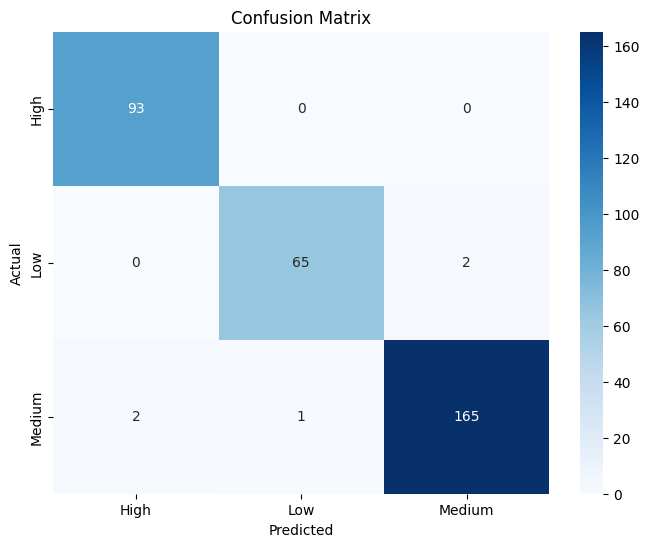

In [45]:
# realizar predicciones sobre el conjunto de prueba
y_pred = logistic_regression_model.predict(X_test_transformed)

# calcular métricas de evaluación para cada clase - classification report
class_report = classification_report(y_test, y_pred)
print(class_report)

# generar matriz de confusión y visualizar
conf_matrix = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8,6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=logistic_regression_model.classes_, yticklabels=logistic_regression_model.classes_)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

Notamos que los resultados obtenidos con el modelo de regresión logística sin regularización son bastante buenos, indicando que las columnas que se mantuvieron en el dataset después de la limpieza de datos son bastante relevantes para la predicción de la variable objetivo. Si analizamos los coeficientes lo más probable es que la columna `Emission_Reduction_%` sea la que tenga el coeficiente más alto, lo que indicaría que es la variable más relevante para la predicción de la variable objetivo.

In [46]:
# obtener los coeficientes del modelo
coeficientes = logistic_regression_model.coef_[0]
nombres_variables = trasformation.get_feature_names_out() # obtener los nombres de las variables después de la transformación
coeficientes_df = pd.DataFrame({'Variable': nombres_variables, 'Coeficiente': coeficientes}) # crear un DataFrame con los nombres de las variables y sus coeficientes
coeficientes_df = coeficientes_df.sort_values(by='Coeficiente', ascending=False) # ordenar el DataFrame por los coeficientes de mayor a menor
print(coeficientes_df)

                                       Variable  Coeficiente
19                 scaler__Emission_Reduction_%     8.536802
4           onehot__Lifecycle_Phase_End-of-life     0.201756
13        scaler__Electric_Power_Emission_tCO2e     0.153453
18           scaler__Urban_Sustainability_Score     0.133370
15                     scaler__Material_Reuse_%     0.129142
0                onehot__Project_Type_High-rise     0.100177
5   onehot__Lifecycle_Phase_Material Production     0.066047
3          onehot__Lifecycle_Phase_Construction     0.033591
9              scaler__Embodied_Emissions_tCO2e     0.031334
14      scaler__Lighting_Fixture_Emission_tCO2e     0.011557
16                   scaler__Renewable_Energy_%     0.002865
10          scaler__Operational_Emissions_tCO2e    -0.000571
2                 onehot__Project_Type_Mid-rise    -0.016172
17                 scaler__Waste_Minimization_%    -0.034180
1                 onehot__Project_Type_Low-rise    -0.034910
8                  scale

#### **4. Regularización y Optimización (40%)**

1.  **Regularización**:
    *   Entrena un modelo de regresión logística con regularización `L2` (`C=1.0`).
    *   Compara las métricas de evaluación (`precision`, `recall`, y `f1-score`) con el modelo sin regularización.

In [47]:
regularized_logistic_regression_model = LogisticRegression(penalty='l2', C=1.0, max_iter=1000) # crear el modelo regularizado
regularized_logistic_regression_model.fit(X_train_transformed, y_train) # entrenar

LogisticRegression(max_iter=1000)

              precision    recall  f1-score   support

        High       0.98      1.00      0.99        93
         Low       0.98      0.97      0.98        67
      Medium       0.99      0.98      0.99       168

    accuracy                           0.98       328
   macro avg       0.98      0.98      0.98       328
weighted avg       0.98      0.98      0.98       328



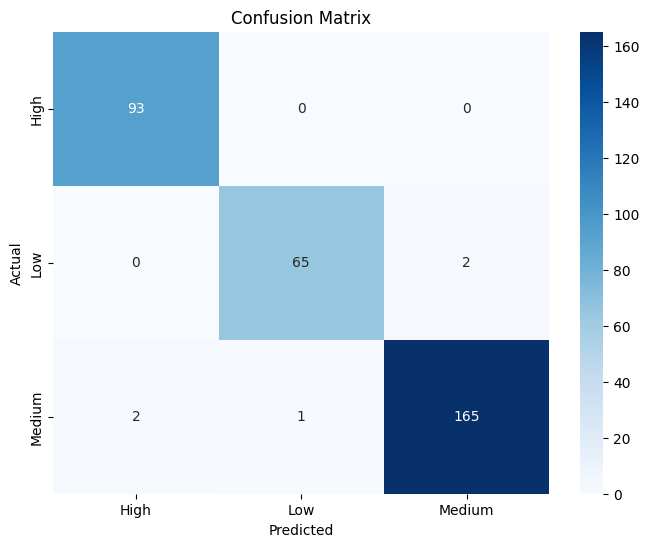

In [48]:
# evaluar el modelo regularizado
# realizar predicciones sobre el conjunto de prueba
y_pred = regularized_logistic_regression_model.predict(X_test_transformed)

# calcular métricas de evaluación para cada clase - classification report
class_report = classification_report(y_test, y_pred)
print(class_report)

# generar matriz de confusión y visualizar
conf_matrix = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8,6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=regularized_logistic_regression_model.classes_, yticklabels=regularized_logistic_regression_model.classes_)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

Comparando los resultados de ambos modelos (regularizado sin búsqueda de hiperparámetros y sin regularización) se observa que los resultados obtenidos son exáctamente los mismos, obteniendo así las mísmas métricas de evaluación (`precision`, `recall`, y `f1-score`) para cada clase. Esto indica que efectuar una búsqueda de hiperparámetros para la regularización es un paso importante para mejorar el rendimiento.

2.  **Optimización de hiperparámetros**:
    *   Usa `GridSearchCV` para encontrar los mejores hiperparámetros (`penalty` y `C`) para el modelo de regresión logística.
    *   Entrena el modelo optimizado y evalúa su rendimiento en el conjunto de prueba.
    *   Responde: ¿Mejoró el rendimiento del modelo después de la optimización?

Best Parameters: {'C': 100, 'penalty': 'l1'}
              precision    recall  f1-score   support

        High       1.00      0.99      0.99        93
         Low       1.00      0.99      0.99        67
      Medium       0.99      1.00      0.99       168

    accuracy                           0.99       328
   macro avg       1.00      0.99      0.99       328
weighted avg       0.99      0.99      0.99       328



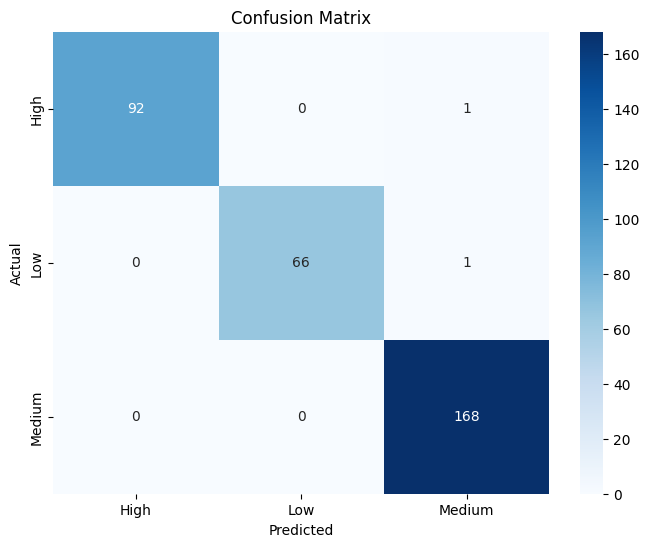

In [ ]:
# creamos el grid de parametros para penalty y C
param_grid = {
    'penalty': ['l1', 'l2', 'elasticnet', 'none'],
    'C': [0.001, 0.01, 0.1, 1, 10, 100]
}

# Inicializar el modelo de regresión logística
log_reg = LogisticRegression(solver='saga', max_iter=10000)

# Hacer la búsqueda
grid_search = GridSearchCV(estimator=log_reg, param_grid=param_grid, cv=5, scoring='accuracy') # usar accuracy como métrica de evaluación y 5 folds
grid_search.fit(X_train_transformed, y_train)

# Obtener el mejor modelo y parámetros
best_params = grid_search.best_params_
best_model = grid_search.best_estimator_

print("Best Parameters:", best_params)

# Evaluar el mejor modelo en el conjunto de prueba
y_pred = best_model.predict(X_test_transformed)
class_report = classification_report(y_test, y_pred)
print(class_report)

# generar matriz de confusión y visualizar
conf_matrix = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8,6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=best_model.classes_, yticklabels=best_model.classes_)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

La búsqueda de hiperparámetros con `GridSearchCV` nos permitió encontrar los mejores parámetros para el modelo de regresión logística con regularización, lo que resultó en una ligera mejora en las métricas de evaluación (`precision`, `recall`, y `f1-score`) en comparación con el modelo sin regularización/sin búsqueda de hiparámetros óptimos. 

Con estos experimentos concluimos que la optimización de hiperparámetros es crucial para encontrar mejoras posibles mejoras en el rendimiento de los modelos.

In [1]:
!jupyter nbconvert --to pdf "e.laverdeb@uniandes.edu.co_lab2.ipynb"

[NbConvertApp] Converting notebook e.laverdeb@uniandes.edu.co_lab2.ipynb to pdf
[NbConvertApp] Support files will be in e.laverdeb@uniandes.edu.co_lab2_files/
[NbConvertApp] Making directory ./e.laverdeb@uniandes.edu.co_lab2_files
[NbConvertApp] Writing 74010 bytes to notebook.tex
[NbConvertApp] Building PDF
[NbConvertApp] Running xelatex 3 times: ['xelatex', 'notebook.tex', '-quiet']
[NbConvertApp] Running bibtex 1 time: ['bibtex', 'notebook']
[NbConvertApp] WARNING | bibtex had problems, most likely because there were no citations
[NbConvertApp] PDF successfully created
[NbConvertApp] Writing 181044 bytes to e.laverdeb@uniandes.edu.co_lab2.pdf
